In [1]:
import numpy as np
from sklearn.datasets import make_blobs, make_moons, make_circles

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from mpl_toolkits.mplot3d import Axes3D

import copy

rc('animation', html='jshtml')
rc('savefig', dpi=100, format='svg')

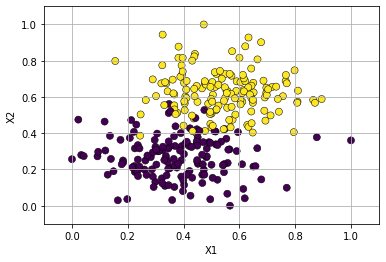

In [2]:
np.random.seed(2)
xx, y = make_blobs(n_samples=300, centers=2, n_features=2, cluster_std=2.5)
# xx, y = make_blobs(n_samples=100, centers=2, n_features=2, cluster_std=1.5)

x1 = xx[:,0]
x2 = xx[:,1]
yy = y.reshape(-1,1)

## MinMax Normalization
x1 = (x1-x1.min())/(x1.max()-x1.min())
x2 = (x2-x2.min())/(x2.max()-x2.min())
xx = np.column_stack((np.ones_like(x1), x1,x2))

%matplotlib inline
plt.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5)
# plt.scatter(x1, x2, c=yy.reshape(-1))#, ec='k')

# (x1min, x1max) = -0.2, 1.2
(x1min, x1max) = -0.1, 1.1

plt.xlim((x1min, x1max))
plt.ylim((x1min, x1max))
plt.xlabel("X1")
plt.ylabel('X2')
plt.grid()

plt.savefig("2D-classification-dataset.svg")

# Imporving Perceptron

## Traditional Perceptron

In [3]:
def step_function(x):
    return float(x>0)

def output(X, W):
    z = (X*W).sum()
    y = step_function(z)
    return y

def error(all_y, all_t):
    err = np.sum(np.abs(all_y - all_t))
    return err

def total_error(XX, W, all_t):
    all_y = []
    for x in XX:
        y = output(x, W)
        all_y.append(y)
    all_y = np.array(all_y)
    err = error(all_y, all_t)
    
    err_indx = np.nonzero(all_y - all_t)[0]
    return err, err_indx, all_y
    

def update(W, X, y, t, learning_rate=0.1):
    delW = (t-y)
    new_W = W + learning_rate*delW*X
    return new_W

In [4]:
## Initialize weights
np.random.seed(1)
W = np.random.randn(3)

## sample points which makes mistake
## THis helps faster convergence... also better animation :D

err_indx = np.arange(0, len(xx), dtype=np.int64)

val_list = []
for step in range(1000):
    indx = err_indx[np.random.randint(len(err_indx))]
    X = xx[indx]
    t = yy[indx][0]
    
    y = output(X, W)
    W = update(W, X, y, t)
    
    err, err_indx, all_y  = total_error(xx, W, yy.reshape(-1))
    if step%20 == 0 or len(err_indx)==0:

        accuracy = (all_y == yy.reshape(-1)).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")

        val_list.append((step, W, err, accuracy))
        
        print()
    
        if err < 1:
            print('fitted to our expectation')
            break

Step: 0 -> Error: 150.0, Accuracy: 0.5

Step: 20 -> Error: 252.0, Accuracy: 0.16

Step: 40 -> Error: 245.0, Accuracy: 0.18333333333333332

Step: 60 -> Error: 231.0, Accuracy: 0.23

Step: 80 -> Error: 168.0, Accuracy: 0.44

Step: 100 -> Error: 51.0, Accuracy: 0.83

Step: 120 -> Error: 133.0, Accuracy: 0.5566666666666666

Step: 140 -> Error: 26.0, Accuracy: 0.9133333333333333

Step: 160 -> Error: 51.0, Accuracy: 0.83

Step: 180 -> Error: 52.0, Accuracy: 0.8266666666666667

Step: 200 -> Error: 115.0, Accuracy: 0.6166666666666667

Step: 220 -> Error: 63.0, Accuracy: 0.79

Step: 240 -> Error: 22.0, Accuracy: 0.9266666666666666

Step: 260 -> Error: 18.0, Accuracy: 0.94

Step: 280 -> Error: 20.0, Accuracy: 0.9333333333333333

Step: 300 -> Error: 18.0, Accuracy: 0.94

Step: 320 -> Error: 19.0, Accuracy: 0.9366666666666666

Step: 340 -> Error: 24.0, Accuracy: 0.92

Step: 360 -> Error: 35.0, Accuracy: 0.8833333333333333

Step: 380 -> Error: 64.0, Accuracy: 0.7866666666666666

Step: 400 -> Error:

####  Animate

In [5]:
num_points = 200
X1s = np.linspace(-0.2, 1.2, num_points)  ## for mesh grid
X2s = np.linspace(-0.2, 1.2, num_points)

x1g, x2g = np.meshgrid(X1s, X2s)

In [6]:
val_list = np.array(val_list)

In [7]:
# %matplotlib inline
# fig, (ax, ax1) = plt.subplots(2, 1, figsize=(6,6),
#                               gridspec_kw={'height_ratios': [2, 1]})
# ax2 = ax1.twinx()
# plt.close()

# err_min, err_max = val_list[:, 2].min(), val_list[:, 2].max()
# eax_min = err_min - (err_max-err_min)*0.05
# eax_max = err_max + (err_max-err_min)*0.05

# acc_min, acc_max = val_list[:, 3].min(), val_list[:, 3].max()
# aax_min = acc_min - (acc_max-acc_min)*0.05
# aax_max = acc_max + (acc_max-acc_min)*0.05


# def animate(i):
#     global val_list
#     if i%10 == 0:
#         print(f'Step {i} / {len(val_list)}')
    
#     step, W, err, acc = val_list[i] 
    
#     ## Plot the function/decision boundary in 2D
#     yg = [output(np.array([1, x1_, x2_]), W) for x1_, x2_ in zip(np.ravel(x1g), np.ravel(x2g))]
#     yg = np.array(yg).reshape(x1g.shape)

#     ax.clear()
#     ax.imshow(yg.reshape(x1g.shape), interpolation='bicubic',
#                extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
#                cmap='plasma',
#                alpha=0.5,
#                aspect='auto', origin='lower')

#     ax.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5)
    
#     ## Plot decision boundary as line
#     (x1min, x1max) = -0.2, 1.2
#     (x1min, x1max) = -0.1, 1.1

#     x2min = (-W[0] - W[1]*x1min)/W[2]
#     x2max = (-W[0] - W[1]*x1max)/W[2]
#     ax.plot([x1min, x1max], [x2min, x2max], lw=3, color='g')
#     ax.set_xlim((x1min, x1max))
#     ax.set_ylim((x1min, x1max))
    
#     ax.grid()
#     ax.set_xlabel("X1")
#     ax.set_ylabel("X2")
#     ax.text(0.34,1.13, f"Steps: {step}")
    
#     ax1.clear()
#     c1 = 'tab:red'
#     ax1.tick_params(axis='y', labelcolor=c1)
#     ax1.set_xlim(0, len(val_list))
#     ax1.set_ylim(eax_min, eax_max)
#     ax1.set_xlabel("Steps")
#     ax1.set_ylabel("Error", color=c1)
#     ax1.plot(val_list[:i, 2], color=c1, lw=1, linestyle='dashed', marker='.')
    
#     ax1.tick_params(
#     axis='x',          # changes apply to the x-axis
#     which='both',      # both major and minor ticks are affected
#     bottom=False,      # ticks along the bottom edge are off
#     top=False,         # ticks along the top edge are off
#     labelbottom=False) # labels along the bottom edge are off
    
#     ax2.clear()
#     c1 = 'tab:green'
#     ax2.tick_params(axis='y', labelcolor=c1)
#     ax2.set_xlim(0, len(val_list))
#     ax2.set_ylim(aax_min, aax_max)
#     ax2.set_ylabel("Accuracy", color=c1)
#     ax2.plot(val_list[:i, 3], color=c1, lw=1, linestyle='dashed', marker='.')
    
    
        
# anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
#                                init_func=lambda:None, interval=100)

In [8]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i] 
    
    ## Plot the function/decision boundary in 2D
    yg = [output(np.array([1, x1_, x2_]), W) for x1_, x2_ in zip(np.ravel(x1g), np.ravel(x2g))]
    yg = np.array(yg).reshape(x1g.shape)

    ax.clear()
    ax.imshow(yg.reshape(x1g.shape), interpolation='bicubic',
               extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
               cmap='plasma',
               alpha=0.5,
               aspect='auto', origin='lower')

    ax.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5)
    
    ## Plot decision boundary as line
    (x1min, x1max) = -0.1, 1.1
    
    x2min = (-W[0] - W[1]*x1min)/W[2]
    x2max = (-W[0] - W[1]*x1max)/W[2]
    ax.plot([x1min, x1max], [x2min, x2max], lw=3, color='g')
    ax.set_xlim((x1min, x1max))
    ax.set_ylim((x1min, x1max))
    
    ax.grid()
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.text(0.1,1.13, f"Steps: {step} Error: {int(err)} Accuracy: {acc:.4f}")
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [146]:
anim

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


In [9]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('original-perceptron-learning.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


## Batch gradient perceptron

In [10]:
def step_function(x):
    return (x>0).astype(float)

def output(X, W):
    z = X@W
    y = step_function(z)
    return y

def error(out, target):
    err = np.sum(np.abs(out - target))
    return err

def update(W, X, out, target, learning_rate=0.1):
    delW = X.T @ (target-out) / len(target)
    new_W = W + learning_rate*delW
    return new_W

In [11]:
## Initialize weights
np.random.seed(1)
W = np.random.randn(3,1)

val_list = []
for step in range(1400):
    yout = output(xx, W)
    W = update(W, xx, yout, yy, 0.05)
    
    err = error(yout, yy)
    if step%100 == 0 or (step>1000 and step%10 == 0):

        accuracy = (yout == yy).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")

        val_list.append((step, W, err, accuracy))
        
        print()
        if err < 0.001 :
            print('fitted to our expectation')
            break

Step: 0 -> Error: 150.0, Accuracy: 0.5

Step: 100 -> Error: 250.0, Accuracy: 0.16666666666666666

Step: 200 -> Error: 166.0, Accuracy: 0.44666666666666666

Step: 300 -> Error: 52.0, Accuracy: 0.8266666666666667

Step: 400 -> Error: 27.0, Accuracy: 0.91

Step: 500 -> Error: 19.0, Accuracy: 0.9366666666666666

Step: 600 -> Error: 12.0, Accuracy: 0.96

Step: 700 -> Error: 15.0, Accuracy: 0.95

Step: 800 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 900 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1000 -> Error: 15.0, Accuracy: 0.95

Step: 1010 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1020 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1030 -> Error: 15.0, Accuracy: 0.95

Step: 1040 -> Error: 15.0, Accuracy: 0.95

Step: 1050 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1060 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1070 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1080 -> Error: 16.0, Accuracy: 0.9466666666666667

Step: 1090 -> Error: 16

##### Animate

In [12]:
val_list = np.array(val_list)
len(val_list)

50

In [13]:
num_points = 200
X1s = np.linspace(-0.2, 1.2, num_points)  ## for mesh grid
X2s = np.linspace(-0.2, 1.2, num_points)

x1g, x2g = np.meshgrid(X1s, X2s)

In [14]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i] 
    
    ## Plot the function/decision boundary in 2D
    yg = [output(np.array([1, x1_, x2_]), W) for x1_, x2_ in zip(np.ravel(x1g), np.ravel(x2g))]
    yg = np.array(yg).reshape(x1g.shape)

    ax.clear()
    ax.imshow(yg.reshape(x1g.shape), interpolation='bicubic',
               extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
               cmap='plasma',
               alpha=0.5,
               aspect='auto', origin='lower')

    ax.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5)
    
    ## Plot decision boundary as line
    (x1min, x1max) = -0.1, 1.1
    x2min = (-W[0] - W[1]*x1min)/W[2]
    x2max = (-W[0] - W[1]*x1max)/W[2]
    ax.plot([x1min, x1max], [x2min, x2max], lw=3, color='g')
    ax.set_xlim((x1min, x1max))
    ax.set_ylim((x1min, x1max))
    
    ax.grid()
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.text(0.1,1.13, f"Steps: {step} Error: {int(err)} Accuracy: {acc:.4f}")
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [153]:
anim

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


In [15]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('batch-perceptron-learning.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


## Probabilistic Batch-Gradient-descent perceptron

In [35]:
def sigmoid(x):
    y = 1 / (1 + np.exp(-x))
    return y

def output(X, W):
    z = X@W
    y = sigmoid(z)
    return y

def error(out, target):
    err = np.sum(np.abs(out - target))
    return err

def update(W, X, output, target, learning_rate=0.1):
    delW = X.T @ (output-target) / len(target)
    new_W = W - learning_rate*delW
    return new_W

In [36]:
## Initialize weights
np.random.seed(1)
W = np.random.randn(3,1)

val_list = []
yout_list = []
for step in range(10000):
    prob = output(xx, W)
    yout = np.random.binomial(1, prob)

    W = update(W, xx, yout, yy, 0.1)
    
    if step%200 == 0:
        
        err = error(yout, yy)
        
        accuracy = ((prob>0.5) == yy).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")
        
        val_list.append((step, W, err, accuracy))
        yout_list.append(yout)
        
        print()
        if err < 0.00025:
            print('fitted to our expectation')
            break

Step: 0 -> Error: 167, Accuracy: 0.5

Step: 200 -> Error: 141, Accuracy: 0.5733333333333334

Step: 400 -> Error: 131, Accuracy: 0.92

Step: 600 -> Error: 104, Accuracy: 0.9333333333333333

Step: 800 -> Error: 99, Accuracy: 0.9366666666666666

Step: 1000 -> Error: 100, Accuracy: 0.9366666666666666

Step: 1200 -> Error: 77, Accuracy: 0.9566666666666667

Step: 1400 -> Error: 69, Accuracy: 0.9533333333333334

Step: 1600 -> Error: 72, Accuracy: 0.9533333333333334

Step: 1800 -> Error: 68, Accuracy: 0.9533333333333334

Step: 2000 -> Error: 69, Accuracy: 0.9533333333333334

Step: 2200 -> Error: 58, Accuracy: 0.9533333333333334

Step: 2400 -> Error: 63, Accuracy: 0.9533333333333334

Step: 2600 -> Error: 63, Accuracy: 0.9533333333333334

Step: 2800 -> Error: 55, Accuracy: 0.9533333333333334

Step: 3000 -> Error: 57, Accuracy: 0.9533333333333334

Step: 3200 -> Error: 47, Accuracy: 0.9533333333333334

Step: 3400 -> Error: 52, Accuracy: 0.9533333333333334

Step: 3600 -> Error: 46, Accuracy: 0.9533

##### Animate

In [37]:
val_list = np.array(val_list)
len(val_list)

50

In [38]:
num_points = 200
X1s = np.linspace(-0.2, 1.2, num_points)  ## for mesh grid
X2s = np.linspace(-0.2, 1.2, num_points)

x1g, x2g = np.meshgrid(X1s, X2s)
img_shape = x1g.shape
x1g = np.ravel(x1g)
x2g = np.ravel(x2g)

inp = np.column_stack((np.ones_like(x1g), x1g, x2g))

In [39]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [44]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
cmap = matplotlib.cm.plasma
norm = matplotlib.colors.Normalize(vmin=0, vmax=1)

plt.close()

def animate(i):
    global val_list, yout_list
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i] 
    
    ## Plot the function/decision boundary in 2D

    yg = output(inp, W)
    ax.clear()
    ax.imshow(yg.reshape(img_shape), interpolation='bicubic',
               extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
               cmap='plasma',
               alpha=0.5,
               aspect='auto', origin='lower')

    ax.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
    yout = yout_list[i]
    ax.scatter(x1, x2, c=yout, marker='.', label="Sampling")
    
    ## Plot decision boundary as line
    (x1min, x1max) = -0.1, 1.1
    x2min = (-W[0] - W[1]*x1min)/W[2]
    x2max = (-W[0] - W[1]*x1max)/W[2]
    ax.plot([x1min, x1max], [x2min, x2max], lw=3, color='g', label="Boundary")
    ax.set_xlim((x1min, x1max))
    ax.set_ylim((x1min, x1max))
    
    ax.grid()
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.text(0.1,1.13, f"Steps: {step} Error: {int(err)} Accuracy: {acc:.4f}")
    ax.legend()
    
    cax.clear()
    fig.colorbar(matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=cax, orientation='vertical', label='P(y=1|X)', alpha=0.5)

    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [186]:
anim

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


In [45]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('sampling-perceptron-learning.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


## Logistic regression

In [46]:
def sigmoid(x):
    y = 1 / (1 + np.exp(-x))
    return y

def output(X, W):
    z = X@W
    y = sigmoid(z)
    return y

def error(output, target, epsilon=1e-11):
    output = output.clip(epsilon, 1 - epsilon)
    return -((target * np.log(output) + (1 - target) * np.log(1 - output)).sum(axis=1)).mean()

def update(W, X, output, target, learning_rate=0.1):
    delW = X.T @ (output-target) / len(target)
    new_W = W - learning_rate*delW
    return new_W

In [47]:
## Initialize weights
np.random.seed(1)
W = np.random.randn(3,1)

val_list = []
yout_list = []
for step in range(2500):
    yout = output(xx, W)
    
    W = update(W, xx, yout, yy, 0.1)
    
    if step%50 == 0:
        err = error(yout, yy)
        
        accuracy = ((yout>0.5) == yy).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")
        
        val_list.append((step, W, err, accuracy))
        yout_list.append(yout)

        print()
        if err < 0.00025:
            print('fitted to our expectation')
            break

Step: 0 -> Error: 0.9142668328572893, Accuracy: 0.5

Step: 50 -> Error: 0.7760322760572181, Accuracy: 0.49666666666666665

Step: 100 -> Error: 0.7315543359703877, Accuracy: 0.47

Step: 150 -> Error: 0.6939435853979556, Accuracy: 0.51

Step: 200 -> Error: 0.6598689104215442, Accuracy: 0.59

Step: 250 -> Error: 0.6289203402906384, Accuracy: 0.72

Step: 300 -> Error: 0.6007879804300101, Accuracy: 0.8033333333333333

Step: 350 -> Error: 0.5751850114591756, Accuracy: 0.8966666666666666

Step: 400 -> Error: 0.5518480340687176, Accuracy: 0.9133333333333333

Step: 450 -> Error: 0.5305379778229002, Accuracy: 0.9233333333333333

Step: 500 -> Error: 0.5110398141960458, Accuracy: 0.9266666666666666

Step: 550 -> Error: 0.49316143078186986, Accuracy: 0.9333333333333333

Step: 600 -> Error: 0.4767320066581927, Accuracy: 0.93

Step: 650 -> Error: 0.4616001419541008, Accuracy: 0.93

Step: 700 -> Error: 0.44763191672021035, Accuracy: 0.9266666666666666

Step: 750 -> Error: 0.43470899254117285, Accuracy

In [48]:
val_list = np.array(val_list)
len(val_list)

50

In [49]:
len(yout_list)

50

##### Animate

In [51]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
cmap = matplotlib.cm.plasma
norm = matplotlib.colors.Normalize(vmin=0, vmax=1)

plt.close()

def animate(i):
    global val_list, yout_list
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i] 
    
    ## Plot the function/decision boundary in 2D
    yg = output(inp, W)
    ax.clear()
    im = ax.imshow(yg.reshape(img_shape), interpolation='bicubic',
               extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
               cmap='plasma',
               alpha=0.5,
               aspect='auto', origin='lower')

    ax.scatter(x1, x2, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
    yout = yout_list[i]
    
    ## Plot decision boundary as line
    (x1min, x1max) = -0.1, 1.1
    x2min = (-W[0] - W[1]*x1min)/W[2]
    x2max = (-W[0] - W[1]*x1max)/W[2]
    ax.plot([x1min, x1max], [x2min, x2max], lw=3, color='green', label="Boundary")
    ax.set_xlim((x1min, x1max))
    ax.set_ylim((x1min, x1max))
    
    ax.grid()
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.text(0.1,1.13, f"Steps: {step} Error: {err:.4f} Accuracy: {acc:.4f}")
    ax.legend()
    
    cax.clear()
    fig.colorbar(matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap),
             cax=cax, orientation='vertical', label='P(y=1|X)', alpha=0.5)

    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [297]:
anim

Step 0 / 50


In [52]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('logistic-regression-2d.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


# Non-linear Regression

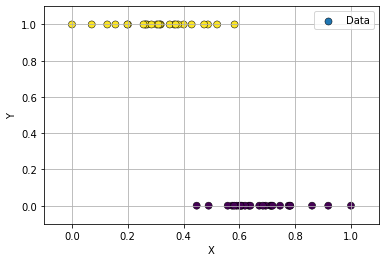

In [53]:
np.random.seed(2)
x, y = make_blobs(n_samples=50, centers=2, n_features=1, cluster_std=2.5)


## MinMax Normalization
x1 = (x-x.min())/(x.max()-x.min())
yy = y.reshape(-1,1)
xx = np.column_stack((np.ones_like(x1), x1))


%matplotlib inline
plt.scatter(x1, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")


(x1min, x1max) = -0.1, 1.1
plt.xlim((x1min, x1max))
plt.ylim((x1min, x1max))
plt.xlabel("X")
plt.ylabel('Y')
plt.grid()
plt.legend()

plt.savefig("classification-as-regression-dataset.svg")

## Logistic regression

In [54]:
## Initialize weights
np.random.seed(4)
W = np.random.randn(2,1)

x1_db = np.linspace(-0.2, 1.2, num=300)
xx_db = np.column_stack((np.ones_like(x1_db), x1_db))

val_list = []
yout_list = []
for step in range(10000):
    yout = output(xx, W)
    
    W = update(W, xx, yout, yy, 0.1)
    
    if step%300 == 0:
        err = error(yout, yy)
        
        accuracy = ((yout>0.5) == yy).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")
        
        val_list.append((step, W, err, accuracy))
        yout_list.append(yout)

        print()
        if err < 0.00025:
            print('fitted to our expectation')
            break

Step: 0 -> Error: 0.7522827079974302, Accuracy: 0.5

Step: 300 -> Error: 0.5556705032698797, Accuracy: 0.9

Step: 600 -> Error: 0.4592093572256119, Accuracy: 0.9

Step: 900 -> Error: 0.3993831483438642, Accuracy: 0.92

Step: 1200 -> Error: 0.3590216915851845, Accuracy: 0.92

Step: 1500 -> Error: 0.32999017624000276, Accuracy: 0.92

Step: 1800 -> Error: 0.30808700275733725, Accuracy: 0.92

Step: 2100 -> Error: 0.2909528735329551, Accuracy: 0.94

Step: 2400 -> Error: 0.2771672243757065, Accuracy: 0.94

Step: 2700 -> Error: 0.26582483073330804, Accuracy: 0.92

Step: 3000 -> Error: 0.25632161045465396, Accuracy: 0.92

Step: 3300 -> Error: 0.2482388309420269, Accuracy: 0.92

Step: 3600 -> Error: 0.24127689482440168, Accuracy: 0.92

Step: 3900 -> Error: 0.23521563127048511, Accuracy: 0.92

Step: 4200 -> Error: 0.22988949768837133, Accuracy: 0.92

Step: 4500 -> Error: 0.22517154445222434, Accuracy: 0.92

Step: 4800 -> Error: 0.22096272864031438, Accuracy: 0.92

Step: 5100 -> Error: 0.21718460

#### Animate

In [55]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list, yout_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i]
    yout = yout_list[i]
    
    ## Plot the function/decision boundary in 2D
    ax.clear()

    ax.scatter(x1, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
    y_db = output(xx_db, W)
    ax.plot(x1_db, y_db, color='red', lw=3, label="Prediction")

    #### plot decision boundary
    db = -W[0]/W[1]
    ax.vlines(db, ymin=-0.1, ymax=1.1, color='green', lw=2, label="Boundary")

    ax.set_xlim((-0.1, 1.1))
    ax.set_ylim((-0.1, 1.1))

    ax.text(0.2, 1.13, f"Steps: {step} Error: {err:.4f} Accuracy: {acc:.2f}")
    
    ax.legend()
    ax.set_xlabel("X1")
    ax.set_ylabel('Y')
    ax.grid()
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [321]:
anim

Step 0 / 34
Step 10 / 34
Step 20 / 34
Step 30 / 34


In [56]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('logistic-regression-1d.gif', writer=writer_gif, dpi=100)

Step 0 / 34
Step 10 / 34
Step 20 / 34
Step 30 / 34


## Sigmoid Regression

In [132]:
def sigmoid(x):
    y = 1 / (1 + np.exp(-x))
    return y

def output(X, W):
    z = X@W
    y = sigmoid(z)
    return y

def error(output, target, epsilon=1e-11):
    return ((output-target)**2).mean()

def update(W, X, output, target, learning_rate=0.1):
    dely = (output-target) / len(target)
    delz = (output)*(1-output)*dely
    delW = X.T @ delz
    new_W = W - learning_rate*delW
    return new_W

In [60]:
## Initialize weights
np.random.seed(4)
W = np.random.randn(2,1)

x1_db = np.linspace(-0.2, 1.2, num=300)
xx_db = np.column_stack((np.ones_like(x1_db), x1_db))

val_list = []
yout_list = []
for step in range(10000):
    yout = output(xx, W)
    
    W = update(W, xx, yout, yy, 0.1)
    
    if step%300 == 0:
        err = error(yout, yy)
        
        accuracy = ((yout>0.5) == yy).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")
        
        val_list.append((step, W, err, accuracy))
        yout_list.append(yout)

        print()
        if err < 0.00025:
            print('fitted to our expectation')
            break

Step: 0 -> Error: 0.2789126376481289, Accuracy: 0.5

Step: 300 -> Error: 0.24036292960894262, Accuracy: 0.52

Step: 600 -> Error: 0.2179979383443383, Accuracy: 0.8

Step: 900 -> Error: 0.19931930820947866, Accuracy: 0.9

Step: 1200 -> Error: 0.18375179983638726, Accuracy: 0.92

Step: 1500 -> Error: 0.1707725002999698, Accuracy: 0.9

Step: 1800 -> Error: 0.1598942603850628, Accuracy: 0.9

Step: 2100 -> Error: 0.15070543524195182, Accuracy: 0.9

Step: 2400 -> Error: 0.14287431064444658, Accuracy: 0.9

Step: 2700 -> Error: 0.13613932263896306, Accuracy: 0.9

Step: 3000 -> Error: 0.13029579102019884, Accuracy: 0.92

Step: 3300 -> Error: 0.12518350802680767, Accuracy: 0.92

Step: 3600 -> Error: 0.12067649062117203, Accuracy: 0.92

Step: 3900 -> Error: 0.11667497078875445, Accuracy: 0.92

Step: 4200 -> Error: 0.1130992902792464, Accuracy: 0.92

Step: 4500 -> Error: 0.10988529400847316, Accuracy: 0.92

Step: 4800 -> Error: 0.1069808611908415, Accuracy: 0.92

Step: 5100 -> Error: 0.10434328632

##### Animate

In [61]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list, yout_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, W, err, acc = val_list[i]
    yout = yout_list[i]
    
    ## Plot the function/decision boundary in 2D
    ax.clear()

    ax.scatter(x1, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
    y_db = output(xx_db, W)
    ax.plot(x1_db, y_db, color='red', lw=3, label="Prediction")

    #### plot decision boundary
    db = -W[0]/W[1]
    ax.vlines(db, ymin=-0.1, ymax=1.1, color='green', lw=2, label="Boundary")

    ax.set_xlim((-0.1, 1.1))
    ax.set_ylim((-0.1, 1.1))

    ax.text(0.2, 1.13, f"Steps: {step} Error: {err:.4f} Accuracy: {acc:.2f}")
    
    ax.legend()
    ax.set_xlabel("X1")
    ax.set_ylabel('Y')
    ax.grid()
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [325]:
anim

Step 0 / 34
Step 10 / 34
Step 20 / 34
Step 30 / 34


In [62]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('sigmoid-regression-2d.gif', writer=writer_gif, dpi=100)

Step 0 / 34
Step 10 / 34
Step 20 / 34
Step 30 / 34


## S shaped function

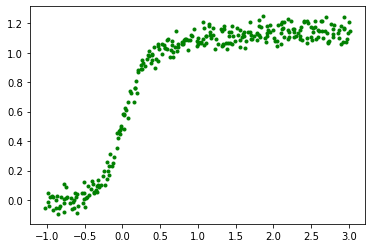

In [70]:
x = np.linspace(-1,3,300)
noise = np.random.normal(0,0.02, x.shape)
x = x + noise
x = np.sort(x)

y = 1.3/np.pi*np.arctan(5*x)+ 0.52
y_original = y
noise = np.random.normal(0,0.05, x.shape)
y = y + noise

x = x
# x = x - x.mean() # good practice to zero-center x in linear mapping

# xx = x.reshape(-1,1)
xx = np.column_stack((np.ones_like(x), x))
yy = y.reshape(-1,1)

%matplotlib inline
plt.scatter(x, y, marker='.', color='g')
plt.show()

In [74]:
jump = 100

## Initialize weights
np.random.seed(4)
W = np.random.randn(2,1)

val_list = []
yout_list = []

for step in range(100000):
    yout = output(xx, W)
    
    W = update(W, xx, yout, yy, 0.2)
    
    if step%jump == 0:
        jump += jump
        err = error(yout, yy)
        
        print(f"Step: {step} -> Error: {err}")
        
        val_list.append((step, err))
        yout_list.append(yout)

        plt.pause(0.01)
        print()
        if err < 0.00025 or step >= 25600*2:
            print('fitted to our expectation')
            break
            


        

Step: 0 -> Error: 0.1541432361331509

Step: 200 -> Error: 0.04618700503896178

Step: 400 -> Error: 0.033735601072291684

Step: 800 -> Error: 0.024844011520541946

Step: 1600 -> Error: 0.019011289937151805

Step: 3200 -> Error: 0.015398235539888946

Step: 6400 -> Error: 0.013298371970355024

Step: 12800 -> Error: 0.012188205455563957

Step: 25600 -> Error: 0.011687135055959414

Step: 51200 -> Error: 0.011517328428928397

fitted to our expectation


##### Animate

In [75]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list, yout_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, err = val_list[i]
    yout = yout_list[i]
    
    ax.clear()
    ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
#         ax.scatter(x, yy, color='g', s=50, edgecolors='k', lw=0.5, label="Data")
    ax.plot(x, y_original, lw=3, color="c", label="Original")
    ax.plot(x, yout, lw=3, color="r", label="Prediction")

    ax.text(0.0, 1.34, f"Steps: {step} Error: {err:.4f}")

    ax.legend()
    ax.set_xlabel("X1")
    ax.set_ylabel('Y')
    ax.grid()
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [ ]:
anim

In [76]:
writer_gif = animation.ImageMagickWriter(fps=5)
anim.save('s-shaped-regression-1d.gif', writer=writer_gif, dpi=100)

Step 0 / 10


## Variation of Sigmoid

In [77]:
x = np.linspace(-5, 5, num=300)
w1 = 1
b1 = 0
w2 = 1
b2 = 0

y_list = []
steps_change = []
color_list = ['red', 'green', 'blue', 'purple']

param_list = []

# change w1 from 1 to 0.2 and to 10
w1s = np.concatenate([np.linspace(1, -5, 10), np.linspace(-5, 7, 10), np.linspace(7, 1, 7)])
for i in range(len(w1s)):
    w1 = w1s[i]
    z1 = w1*x + b1
    a1 = sigmoid(z1)
    y = w2*a1 + b2 
    
    y_list.append(y)
    param_list.append((w1, b1, w2, b2))

b1s = np.concatenate([np.linspace(0, -4, 10), np.linspace(-4, 4, 15), np.linspace(4, 0, 8)])
steps_change.append(len(y_list))
for i in range(len(b1s)):
    b1 = b1s[i]
    z1 = w1*x + b1
    a1 = sigmoid(z1)
    y = w2*a1 + b2 
    
    y_list.append(y)
    param_list.append((w1, b1, w2, b2))
    
    
w2s = np.concatenate([np.linspace(1, -2, 15), np.linspace(-2, 1, 15)])
steps_change.append(len(y_list))
for i in range(len(w2s)):
    w2 = w2s[i]
    z1 = w1*x + b1
    a1 = sigmoid(z1)
    y = w2*a1 + b2 
    
    y_list.append(y)
    param_list.append((w1, b1, w2, b2))
    

b2s = np.concatenate([np.linspace(0, 0.5, 5), np.linspace(0.5, -1, 15), np.linspace(-1, 0, 10)])
steps_change.append(len(y_list))
for i in range(len(b2s)):
    b2 = b2s[i]
    z1 = w1*x + b1
    a1 = sigmoid(z1)
    y = w2*a1 + b2  
    
    y_list.append(y)
    param_list.append((w1, b1, w2, b2))
    
    
steps_change.append(len(y_list))

#### Animate

In [79]:
%matplotlib inline
fig, ax = plt.subplots(1, 1, figsize=(5,4))
plt.close()

def animate(i):
    global y_list, color_list, steps_change, param_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(y_list)}')
        
    y = y_list[i]
    w1, b1, w2, b2 = param_list[i]
    
    col = None
    if i<steps_change[0]:
        col = color_list[0]
    elif i < steps_change[1]:
        col = color_list[1]
    elif i < steps_change[2]:
        col = color_list[2]
    elif i < steps_change[3]:
        col = color_list[3]
    
    ax.clear()
    ax.axhline(0,color='k')
    ax.axvline(0,color='k')
    ax.grid()

    ax.plot(x, y, color=col, lw=3, label='Function')
    ax.text(-3, 2.03, f'W1={w1:.2f}, b1={b1:.2f}, W2={w2:.2f}, b2={b2:.2f}')
    ax.set_ylim((-2, 2))
    ax.set_xlim((-5, 5))
    ax.legend()


anim = animation.FuncAnimation(fig, animate,frames=len(y_list),
                               init_func=lambda:None, interval=100)

In [80]:
anim

Step 0 / 120
Step 10 / 120
Step 20 / 120
Step 30 / 120
Step 40 / 120
Step 50 / 120
Step 60 / 120
Step 70 / 120
Step 80 / 120
Step 90 / 120
Step 100 / 120
Step 110 / 120


In [81]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('sigmoid-variations-shape.gif', writer=writer_gif, dpi=100)

Step 0 / 120
Step 10 / 120
Step 20 / 120
Step 30 / 120
Step 40 / 120
Step 50 / 120
Step 60 / 120
Step 70 / 120
Step 80 / 120
Step 90 / 120
Step 100 / 120
Step 110 / 120


#### All variations in subplots

In [133]:
%matplotlib inline

fig = plt.figure(figsize=(8,4))
ax0 = fig.add_subplot(221)
ax1 = fig.add_subplot(222)
ax2 = fig.add_subplot(223)
ax3 = fig.add_subplot(224)
plt.close()

x = np.linspace(-4,4,300)

w1s = np.concatenate([np.linspace(1, -5, 10), np.linspace(-5, 7, 10), np.linspace(7, 1, 10)])
b1s = np.concatenate([np.linspace(0, -4, 10), np.linspace(-4, 4, 15), np.linspace(4, 0, 5)])
w2s = np.concatenate([np.linspace(1, -1, 10), np.linspace(-1, 1.5, 15), np.linspace(1.5, 1, 5)])
b2s = np.concatenate([np.linspace(0, 0.5, 5), np.linspace(0.5, -1, 15), np.linspace(-1, 0, 10)])


def animate(i):
    if i%10 == 0:
        print(f'Step {i} / {len(w1s)}')
        
    ax0.clear()    
    ax1.clear()    
    ax2.clear()    
    ax3.clear()    
        
    s0 = sigmoid(x*w1s[i])
    ax0.axhline(0,color='k')
    ax0.axvline(0,color='k')
    ax0.grid()
    ax0.plot(x, s0, lw=2, color=color_list[0])
    ax0.set_ylim((-1.1, 1.1))
    ax0.text(-4, -0.9, f"w1: {w1s[i]:.2f}")

    ax0.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=True,          # ticks along the top edge are on
    labelbottom=False, # labels along the bottom edge are off
    labeltop=True)     # label on top edge are on

    
    s1 = sigmoid(x+b1s[i])
    ax1.axhline(0,color='k')
    ax1.axvline(0,color='k')
    ax1.grid()
    ax1.plot(x, s1, lw=2, color=color_list[1])
    ax1.set_ylim((-1.1, 1.1))
    ax1.text(-4, -0.9, f"b1: {b1s[i]:.2f}")
    
    ax1.tick_params(
    axis='x',          
    which='both',      
    bottom=False,      
    top=True,          
    labelbottom=False, 
    labeltop=True)
    ax1.tick_params(
    axis='y',          
    which='both',      
    left=False,      
    right=True,          
    labelleft=False, 
    labelright=True)
    
    s2 = sigmoid(x)*w2s[i]
    ax2.axhline(0,color='k')
    ax2.axvline(0,color='k')
    ax2.grid()
    ax2.plot(x, s2, lw=2, color=color_list[2])
    ax2.set_ylim((-1.1, 1.1))
    ax2.text(-4, 0.75, f"w2: {w2s[i]:.2f}")
    
    s3 = sigmoid(x)+b2s[i]
    ax3.axhline(0,color='k')
    ax3.axvline(0,color='k')
    ax3.grid()
    ax3.plot(x, s3, lw=2, color=color_list[3])
    ax3.set_ylim((-1.1, 1.1))
    ax3.text(-4, 0.75, f"b2: {b2s[i]:.2f}")
    
    ax3.tick_params(
    axis='y',          
    which='both',      
    left=False,      
    right=True,          
    labelleft=False, 
    labelright=True)



anim = animation.FuncAnimation(fig, animate,frames=len(w1s),
                               init_func=lambda:None, interval=100)

In [134]:
anim

Step 0 / 30
Step 10 / 30
Step 20 / 30


In [135]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('sigmoid-variations-subplots.gif', writer=writer_gif, dpi=100)

Step 0 / 30
Step 10 / 30
Step 20 / 30


## More complicated function

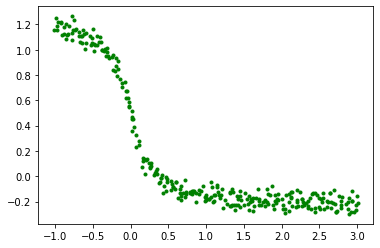

In [107]:
x = np.linspace(-1,3,300)
noise = np.random.normal(0,0.02, x.shape)
x = x + noise
x = np.sort(x)

y = -1.5/np.pi*np.arctan(5*x)+ 0.5
y_original = y
noise = np.random.normal(0,0.05, x.shape)
y = y + noise

x = x
# x = x - x.mean() # good practice to zero-center x in linear mapping

xx = x.reshape(-1,1)
yy = y.reshape(-1,1)

%matplotlib inline
plt.scatter(x, y, marker='.', color='g')
plt.show()

In [2]:
class Sigmoid():
    def __init__(self):
        self.out = None
        self.del_output = None

    def forward(self, x):
        self.out = 1 / (1 + np.exp(-x))
        return self.out

    def backward(self, output_delta):
        self.del_output = output_delta
        return (self.out * (1 - self.out)) * output_delta
    
class LinearLayer():

    def __init__(self, input_dim, output_dim):
        self.weights = np.random.randn(input_dim, output_dim) * np.sqrt(2. / input_dim)  
        # Xavier/He initialization
        self.bias = np.zeros(output_dim)

        self.input = None
        self.zee = None

        self.del_weights = None
        self.del_bias = None
        self.del_zee = None
        pass

    def forward(self, input):
        self.input = input
        self.zee = input @ self.weights + self.bias  # @ == .dot
        return self.zee

    def backward(self, output_delta):
        self.del_zee = output_delta
        m = output_delta.shape[0]
        self.del_bias = np.mean(self.del_zee, axis=0)
        self.del_weights = self.input.T.dot(self.del_zee) * 1 / m
        return self.del_zee.dot(self.weights.T)

    def update(self, learning_rate):
        self.weights -= self.del_weights * learning_rate
        self.bias -= self.del_bias * learning_rate
        pass

In [109]:
np.random.seed(4)
linear1 = LinearLayer(1, 1)
sigmoid = Sigmoid()
linear2 = LinearLayer(1, 1)

In [110]:
%matplotlib tk
fig = plt.figure()
ax = fig.add_subplot(111)
jump = 100

val_list = []
yout_list = []
for step in range(100000):
    z1 = linear1.forward(xx)
    a1 = sigmoid.forward(z1)
    yout = linear2.forward(a1)
    
    dy = yout-yy
    da1 = linear2.backward(dy)
    dz1 = sigmoid.backward(da1)
    dx = linear1.backward(dz1)
    
    linear1.update(0.1)
    linear2.update(0.1)
    
    if step%jump == 0:
        jump += jump
        err = error(yout, yy)
        
        print(f"Step: {step} -> Error: {err}")
        
        val_list.append((step, err))
        yout_list.append(yout)
        
        ax.clear()
        ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
        ax.plot(x, yout, lw=3, color="r", label="Prediction")
        
        ax.legend()
        ax.set_xlabel("X")
        ax.set_ylabel('Y')
        ax.grid()

        fig.canvas.draw()
        plt.pause(0.01)
        print()
        if err < 0.00025 or step >= 25600*2:
            print('fitted to our expectation')
            plt.close()
            break

Step: 0 -> Error: 0.3218934684380778

Step: 200 -> Error: 0.06613557928017738

Step: 400 -> Error: 0.025040743416581246

Step: 800 -> Error: 0.013672076665927175

Step: 1600 -> Error: 0.009618343636584916

Step: 3200 -> Error: 0.00759567809513654

Step: 6400 -> Error: 0.0054796980528869456

Step: 12800 -> Error: 0.003912385219938637

Step: 25600 -> Error: 0.0031291900694616695

Step: 51200 -> Error: 0.002866233776882083

fitted to our expectation


##### Animate

In [121]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list, yout_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, err = val_list[i]
    yout = yout_list[i]
    
    ax.clear()
    ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
#         ax.scatter(x, yy, color='g', s=50, edgecolors='k', lw=0.5, label="Data")
    ax.plot(x, y_original, lw=3, color="c", label="Original")
    ax.plot(x, yout, lw=3, color="r", label="Prediction")

    ax.text(0.0, 1.36, f"Steps: {step} Error: {err:.4f}")

    ax.legend()
    ax.set_xlabel("X")
    ax.set_ylabel('Y')
    ax.set_ylim((-0.4, 1.35))
    ax.grid()
    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [122]:
anim

Step 0 / 10


In [123]:
writer_gif = animation.ImageMagickWriter(fps=5)
anim.save('inverted-s-shaped-regression.gif', writer=writer_gif, dpi=100)

Step 0 / 10


## Adding simple functions (superposition)

In [127]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

x = np.linspace(-5, 5, num=300)
sigmoid = Sigmoid()

def transformed_sigmoid(x, w1, b1, w2, b2):
    z1 = w1*x + b1
    a1 = sigmoid.forward(z1)
    y = w2*a1 + b2
    return y
    
### set random values of these functions
np.random.seed(27)

num_sigm = 2
colors = ['orange', 'yellow', 'y', 'lime', 'deepskyblue', 'deeppink']

def animate(i):
    global num_sigm, colors
    print(f'Step {i}')

    if i < 8:
        num_sigm = 2
    else:
        num_sigm += (i+1)%2 ## 8->1, 9->0, 10->1, ...
        
    ax.clear()
    ax.grid()

    yout = 0
    for i in range(num_sigm):
        w1, b1, w2, b2 = np.random.uniform(-4, 4, 4).tolist()
        y1 = transformed_sigmoid(x, w1, b1, w2, b2)
        yout += y1
        ax.plot(x, y1, color=colors[i], lw=2, label=f'f{i}', linestyle='dashed')

    ax.plot(x, yout, color='r', lw=3, label='Function')
    
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    
    ax.legend()


anim = animation.FuncAnimation(fig, animate,frames=14,
                               init_func=lambda:None, interval=1000)

In [128]:
anim

Step 0
Step 1
Step 2
Step 3
Step 4
Step 5
Step 6
Step 7
Step 8
Step 9
Step 10
Step 11
Step 12
Step 13


In [129]:
writer_gif = animation.ImageMagickWriter(fps=1)
anim.save('superposition-sigmoid.gif', writer=writer_gif, dpi=100)

Step 0
Step 1
Step 2
Step 3
Step 4
Step 5
Step 6
Step 7
Step 8
Step 9
Step 10
Step 11
Step 12
Step 13


## Even More complicated function

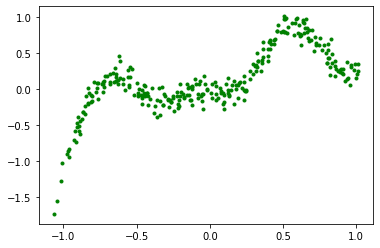

In [148]:
np.random.seed(1321)
x = np.linspace(0,1,300)
noise = np.random.normal(0,0.02, x.shape)
x = x + noise
x = np.sort(x)

y= (2 * np.sin(10*x) + np.cos(20 * x - 3) + 3 * np.log(10*x + 0.5) - 4)/6.
noise = np.random.normal(0,0.1, x.shape)
y = y + noise

x = x*2
x = x - x.mean() # good practice to zero-center x in linear mapping
xx = x.reshape(-1,1)
yy = y.reshape(-1,1)

%matplotlib inline
plt.scatter(x, y, marker='.', color='g')
plt.show()

In [149]:
np.random.seed(8)
linear1 = LinearLayer(1, 5)
linear1.weights*=3.
sigmoid = Sigmoid()
linear2 = LinearLayer(5, 1)
# linear2.weights*=3.

In [150]:
# %matplotlib tk
# fig = plt.figure()
# ax = fig.add_subplot(111)
jump = 500

val_list = []
yout_list = []

for step in range(25000):
    z1 = linear1.forward(xx)
    a1 = sigmoid.forward(z1)
    yout = linear2.forward(a1)
    dy = yout-yy
    
    if step%jump == 0:
        err = 0.5*(dy**2).mean()
        
        print(f"Step: {step} -> Error: {err}")
        
        val_list.append((step, err))
        
        all_y = [yout, ]
        for i in range(linear2.weights.shape[0]):
            yi = a1[:,i]*linear2.weights[i]# + linear2.bias/linear2.weights.shape[0]
            all_y.append(yi)
        all_y.append(np.zeros_like(x)+linear2.bias)
        yout_list.append(all_y)
        
        print()
        if err < 0.0025:
            print('fitted to our expectation')
            break
            
        
    da1 = linear2.backward(dy)
    dz1 = sigmoid.backward(da1)
    dx = linear1.backward(dz1)
    
    linear1.update(0.4)
    linear2.update(0.4)

Step: 0 -> Error: 3.398960157957807

Step: 500 -> Error: 0.04105179890308184

Step: 1000 -> Error: 0.04052157767987063

Step: 1500 -> Error: 0.04017893099007677

Step: 2000 -> Error: 0.03985842189324652

Step: 2500 -> Error: 0.03949954682138041

Step: 3000 -> Error: 0.03903581052376295

Step: 3500 -> Error: 0.038357330541381296

Step: 4000 -> Error: 0.03725340295835403

Step: 4500 -> Error: 0.03531031515614375

Step: 5000 -> Error: 0.03218495931255644

Step: 5500 -> Error: 0.0292620829086097

Step: 6000 -> Error: 0.02736029810200555

Step: 6500 -> Error: 0.025788764472254106

Step: 7000 -> Error: 0.024295818698623167

Step: 7500 -> Error: 0.02283705414248044

Step: 8000 -> Error: 0.021398288881682773

Step: 8500 -> Error: 0.019947435164425008

Step: 9000 -> Error: 0.018448145636285242

Step: 9500 -> Error: 0.01689693946086479

Step: 10000 -> Error: 0.01533559986681448

Step: 10500 -> Error: 0.013834041089420003

Step: 11000 -> Error: 0.01246369166047437

Step: 11500 -> Error: 0.0112751

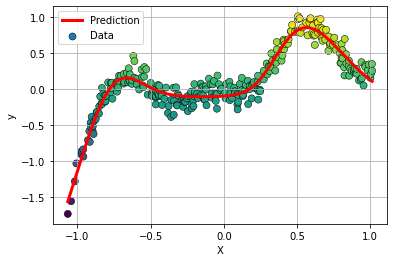

In [151]:
%matplotlib inline
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
ax.plot(x, yout, lw=3, color="r", label="Prediction")
ax.legend()
ax.set_xlabel("X")
ax.set_ylabel('y')
ax.grid()

#### Animate

In [152]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

colors = ['orange', 'yellow', 'y', 'lime', 'deepskyblue', 'deeppink']

def animate(i):
    global val_list, yout_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step, err = val_list[i]
    youts = yout_list[i]
    

    yout = youts[0]
    ax.clear()
    ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
    ax.plot(x, yout, lw=3, color="r", label="Prediction")


    for i in range(1, len(youts)):
        yi = youts[i]
        ax.plot(x, yi, lw=2, color=colors[i-1], linestyle='dashed')


    ax.text(-0.5, 1.15, f"Steps: {step} Error: {err:.4f}")
    ax.legend()
    ax.set_xlabel("X")
    ax.set_ylabel('Y')
    ax.set_xlim((x.min()-0.1, x.max()+0.1))
    ax.set_ylim((y.min()-0.1, y.max()+0.1))
    ax.grid()

    

anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=200)

In [457]:
anim

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


In [154]:
writer_gif = animation.ImageMagickWriter(fps=5)
anim.save('non-linear-regression-mlp.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


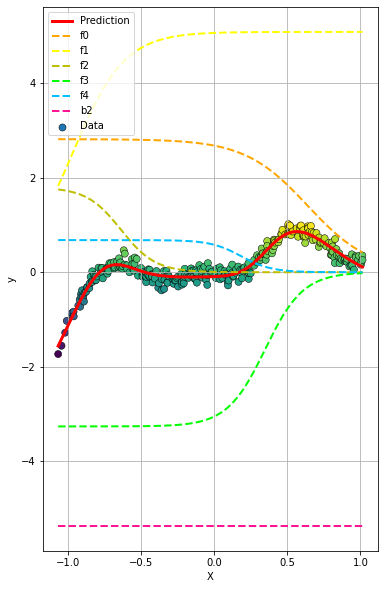

In [156]:
%matplotlib inline
fig = plt.figure(figsize=(6,10))
ax = fig.add_subplot(111)
ax.scatter(x, yy, c=yy, s=50, edgecolors='k', lw=0.5, label="Data")
ax.plot(x, yout, lw=3, color="r", label="Prediction")
for i in range(linear2.weights.shape[0]):
    yi = a1[:,i]*linear2.weights[i]# + linear2.bias/linear2.weights.shape[0]
    ax.plot(x, yi, lw=2, color=colors[i], linestyle='dashed', label=f'f{i}')
    
ax.plot(x, np.zeros_like(x)+linear2.bias, lw=2, color=colors[-1], linestyle='dashed', label=f'b2')

ax.legend()
ax.set_xlabel("X")
ax.set_ylabel('y')
ax.grid()

plt.savefig("nn-regression-with-superposition.svg")

## Activation functions

In [3]:
class Gaussian():
    def __init__(self):
        self.input = None
        self.out = None
        self.del_output = None

    def forward(self, x):
        self.input = x
        self.out = np.exp(-x**2)
        return self.out

    def backward(self, output_delta):
        self.del_output = output_delta
        return (-2 * self.input * self.out) * output_delta


class Tanh():
    def __init__(self):
        self.out = None
        self.del_output = None

    def forward(self, x):
        self.out = 2 / (1 + np.exp(-2 * x)) - 1
        return self.out

    def backward(self, output_delta):
        self.del_output = output_delta
        return (1 - self.out ** 2) * output_delta


class Relu():
    def __init__(self):
        self.x = None
        self.del_output = None


    def forward(self, x):
        self.x = x
        return np.maximum(0, x)

    def backward(self, output_delta):
        self.del_output = output_delta
        return ((self.x >= 0).astype(float)) * output_delta

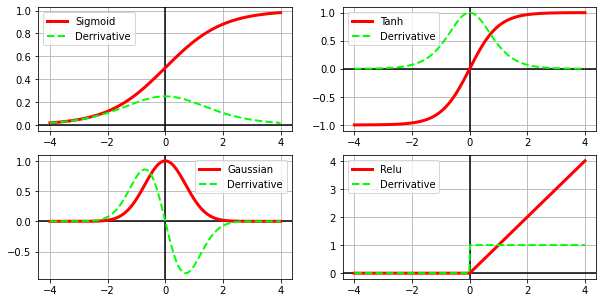

In [158]:
%matplotlib inline

fig = plt.figure(figsize=(10,5))
ax0 = fig.add_subplot(221)
ax1 = fig.add_subplot(222)
ax2 = fig.add_subplot(223)
ax3 = fig.add_subplot(224)

x = np.linspace(-4,4,300)

sigmoid = Sigmoid()
sigmoid_ = sigmoid.forward(x)
s_derr_ = sigmoid.backward(1)

ax0.axhline(0,color='k')
ax0.axvline(0,color='k')
ax0.grid()
ax0.plot(x, sigmoid_, lw=3, color="r", label="Sigmoid")
ax0.plot(x, s_derr_, lw=2, color="lime", linestyle='dashed', label="Derrivative")
ax0.legend()

tanh = Tanh()
tanh_ = tanh.forward(x)
t_derr_ = tanh.backward(1)
ax1.axhline(0,color='k')
ax1.axvline(0,color='k')
ax1.grid()
ax1.plot(x, tanh_, lw=3, color="r", label="Tanh")
ax1.plot(x, t_derr_, lw=2, color="lime", linestyle='dashed', label="Derrivative")
ax1.legend()

gaussian = Gaussian()
gaussian_ = gaussian.forward(x)
g_derr_ = gaussian.backward(1)
ax2.axhline(0,color='k')
ax2.axvline(0,color='k')
ax2.grid()
ax2.plot(x, gaussian_, lw=3, color="r", label="Gaussian")
ax2.plot(x, g_derr_, lw=2, color="lime", linestyle='dashed', label="Derrivative")
ax2.legend()

relu = Relu()
relu_ = relu.forward(x)
r_derr_ = relu.backward(1)
ax3.axhline(0,color='k')
ax3.axvline(0,color='k')
ax3.grid()
ax3.plot(x, relu_, lw=3, color="r", label="Relu")
ax3.plot(x, r_derr_, lw=2, color="lime", linestyle='dashed', label="Derrivative")
ax3.legend()

plt.savefig('activation-functions.svg')

## MLP for 3 classes output

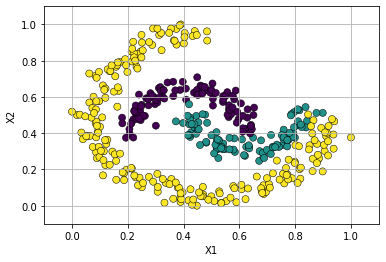

In [4]:
np.random.seed(249) ## 148, 249

xxc, yc = make_circles(n_samples=600, factor=.5,
                                      noise=.09)
idx = yc==0
xxc = xxc[idx]
yc = yc[idx]

idx = (xxc[:,0]+xxc[:,1]<1)
xxc = xxc[idx]
yc = yc[idx]


xxm, ym = make_moons(n_samples=200, noise=.15)
xxm = xxm/2 - 0.2

xx = np.concatenate((xxm, xxc), axis=0)
y = np.concatenate((ym, yc+2), axis=0)

## MinMax Normalization
x1 = xx[:,0]
x2 = xx[:,1]
x1 = (x1-x1.min())/(x1.max()-x1.min())
x2 = (x2-x2.min())/(x2.max()-x2.min())
xx = np.column_stack((x1,x2))

%matplotlib inline
plt.scatter(x1, x2, c=y, s=50, edgecolors='k', lw=0.5)

(x1min, x1max) = -0.1, 1.1
plt.xlim((x1min, x1max))
plt.ylim((x1min, x1max))
plt.xlabel("X1")
plt.ylabel('X2')
plt.grid()

plt.savefig("2D-classification-dataset.svg")

In [5]:
class SoftmaxCrossEntropy():
    @staticmethod
    def loss(output, target, epsilon=1e-11):
        # Prevent overflow
        output = output.clip(epsilon, 1 - epsilon)
        exps = np.e ** output
        probs = exps / exps.sum()
        return -((target * np.log(probs)).sum(axis=1)).mean()

    @staticmethod
    def del_loss(output, target, epsilon=1e-11):
        output = output.clip(epsilon, 1 - epsilon)
        return (output - target)
    
class Logits():
    @staticmethod
    def index_to_logit(index, length=None):
        index = index.astype(int)
        size = len(index)
        if length is None:
            length = np.max(index) + 1
        logits = np.zeros([size, length])
        for indx in range(size):
            logits[indx, index[indx]] = 1
        return logits

    @staticmethod
    def logit_to_index(logits):
        return np.argmax(logits, axis=1)

In [6]:
yy = Logits().index_to_logit(y)

In [12]:
np.random.seed(8)
linear1 = LinearLayer(2, 12)
tanh = Tanh()
linear2 = LinearLayer(12, 3)

In [13]:
%matplotlib tk
jump = 300

val_list = []
param_list = []

for step in range(15000):
    z1 = linear1.forward(xx)
    a1 = tanh.forward(z1)
    yout = linear2.forward(a1)
    
    dy = SoftmaxCrossEntropy().del_loss(yout, yy)
    da1 = linear2.backward(dy)
    dz1 = tanh.backward(da1)
    dx = linear1.backward(dz1)
    
    linear1.update(0.5)
    linear2.update(0.5)
    
    if step%jump == 0:
        err = SoftmaxCrossEntropy().loss(yout, yy)
        
        out = yout.argmax(axis=1)
        accuracy = (out == y).astype(float).mean()
        print(f"Step: {step} -> Error: {err}, Accuracy: {accuracy}")
        
        val_list.append(step)
        params = [copy.deepcopy(linear1.weights),
                  copy.deepcopy(linear1.bias), 
                  copy.deepcopy(linear2.weights), 
                  copy.deepcopy(linear2.bias)]
        param_list.append(params)
        
        print()
        if err < 0.001 :
            print('fitted to our expectation')
            break

Step: 0 -> Error: 7.2193814987512415, Accuracy: 0.2364066193853428

Step: 300 -> Error: 6.839712223290463, Accuracy: 0.7541371158392435

Step: 600 -> Error: 6.8110202616050275, Accuracy: 0.806146572104019

Step: 900 -> Error: 6.794867522551177, Accuracy: 0.8486997635933806

Step: 1200 -> Error: 6.773422557181644, Accuracy: 0.8699763593380615

Step: 1500 -> Error: 6.747975814019952, Accuracy: 0.9054373522458629

Step: 1800 -> Error: 6.730190052385879, Accuracy: 0.9219858156028369

Step: 2100 -> Error: 6.72030936461406, Accuracy: 0.9243498817966903

Step: 2400 -> Error: 6.713826097971057, Accuracy: 0.9267139479905437

Step: 2700 -> Error: 6.709428297365825, Accuracy: 0.933806146572104

Step: 3000 -> Error: 6.706205882033664, Accuracy: 0.933806146572104

Step: 3300 -> Error: 6.703923563216404, Accuracy: 0.9361702127659575

Step: 3600 -> Error: 6.6968692592295165, Accuracy: 0.933806146572104

Step: 3900 -> Error: 6.694108025677404, Accuracy: 0.933806146572104

Step: 4200 -> Error: 6.690691

#### Animation

In [14]:
num_points = 500
X1s = np.linspace(-0.1, 1.1, num_points)  ## for mesh grid
X2s = np.linspace(-0.2, 1.2, num_points)

x1g, x2g = np.meshgrid(X1s, X2s)
img_shape = x1g.shape
x1g = np.ravel(x1g)
x2g = np.ravel(x2g)

inp = np.column_stack((x1g, x2g))

In [15]:
%matplotlib inline
fig, ax = plt.subplots(1, 1)
plt.close()

def animate(i):
    global val_list, param_list
    
    if i%10 == 0:
        print(f'Step {i} / {len(val_list)}')
    
    step = val_list[i]
    
    linear1.weights, linear1.bias, linear2.weights, linear2.bias = param_list[i]    

    z1 = linear1.forward(xx)
    a1 = tanh.forward(z1)
    yout = linear2.forward(a1)
    
    err = SoftmaxCrossEntropy().loss(yout, yy)
    out = yout.argmax(axis=1)
    acc = (out == y).astype(float).mean()

    ## Plot the function/decision boundary in 2D
    z1 = linear1.forward(inp)
    a1 = tanh.forward(z1)
    yg = linear2.forward(a1)
    out_img = np.argmax(yg, axis=1).astype(float)/2.
    
    ax.clear()
    ax.imshow(out_img.reshape(img_shape), interpolation='nearest',
               extent=(x1g.min(), x1g.max(), x2g.min(), x2g.max()),
               cmap='viridis',
               alpha=0.5,
               aspect='auto', origin='lower')

    ax.scatter(x1, x2, c=y, s=50, edgecolors='k', lw=0.5, label="Data")
    ax.text(0.2, 1.13, f"Steps: {step} Error: {err:.2f} Accuracy: {acc:.2f}")

    #### plot decision boundary
    ax.set_xlim((-0.1, 1.1))
    ax.set_ylim((-0.1, 1.1))

    ax.legend()
    ax.set_xlabel("X1")
    ax.set_ylabel('X2')
    ax.grid()


anim = animation.FuncAnimation(fig, animate,frames=len(val_list),
                               init_func=lambda:None, interval=100)

In [16]:
anim

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


In [17]:
writer_gif = animation.ImageMagickWriter(fps=10)
anim.save('multiclass-classification.gif', writer=writer_gif, dpi=100)

Step 0 / 50
Step 10 / 50
Step 20 / 50
Step 30 / 50
Step 40 / 50


### Other diagrams

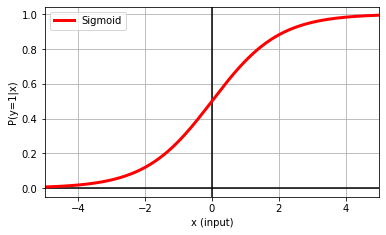

In [175]:
%matplotlib inline

fig = plt.figure(figsize=(6,3.5))
ax0 = fig.add_subplot(111)

x = np.linspace(-5,5,300)
sigmoid = Sigmoid()
sigmoid_ = sigmoid.forward(x)

ax0.axhline(0,color='k')
ax0.axvline(0,color='k')
ax0.grid()
ax0.plot(x, sigmoid_, lw=3, color="r", label="Sigmoid")
ax0.legend()
ax0.set_xlabel('x (input)')
ax0.set_ylabel('P(y=1|x)')
ax0.set_xlim((-5,5))

plt.savefig('sigmoid-function.svg')

In [176]:
np.random.randn(4)@np.random.randn(4,1)

array([0.67581588])